In [1]:
%cd ..

/home/tadenoud/Git/simple-faster-rcnn-pytorch


In [21]:
%matplotlib inline

In [3]:
RANDOM_SEED = 42
SUBSET_SAMPLE_DATA_PERCENTAGE = 0.01
MIN_IOU_REQUIRED = 0.7  # The minimum IOU required to be a good detection (ie higher is more strict)
NUM_PROPOSALS = 300
CHECKPOINT_DIR = './idd_fn_detection'

%load_ext autoreload
%autoreload 2

import os
import torch as t
from model import FasterRCNNVGG16
from trainer import FasterRCNNTrainer
import numpy as np
import pickle
import h5py
from tqdm.auto import tqdm, trange
import matplotlib.pyplot as plt

from data.util import  read_image
from utils.vis_tool import vis_bbox
from utils import array_tool as at
from utils.config import opt
from utils.idd_utils import get_annotations
from model.utils.bbox_tools import bbox_iou

from data.dataset import Dataset, TestDataset, KittiDataset
from torch.utils.data import DataLoader
from utils.vis_tool import vis_bbox, vis_image
from utils.idd_utils import IndiaDrivingDataset
from ood_metrics import auroc, plot_roc, calc_metrics
from sklearn import svm
import pickle
import itertools
import torch
from model.faster_rcnn import nograd
from data.dataset import preprocess
from utils.mahalanobis import Mahal_Dist


import warnings
warnings.filterwarnings(action='once')

np.random.seed(RANDOM_SEED)

In [4]:
opt.voc_data_dir = "./datasets/kitti_2d/VOC2012/"
idd_data_dir = "./datasets/idd_detection/"

kitti_train_dataset = KittiDataset(opt, split='train')
kitti_val_dataset = KittiDataset(opt, split='val')
idd_val_dataset = IndiaDrivingDataset(idd_data_dir, split='val', keep_labels=[0])

# Full datasets samples
kitti_train_samples = len(kitti_train_dataset)
kitti_val_samples = len(kitti_val_dataset)
idd_val_samples = len(idd_val_dataset)

# Subset Datasets
subset_kitti_train_samples = round(len(kitti_train_dataset) * SUBSET_SAMPLE_DATA_PERCENTAGE)
subset_kitti_val_samples = round(len(kitti_val_dataset) * SUBSET_SAMPLE_DATA_PERCENTAGE)
subset_idd_val_samples = round(len(idd_val_dataset) * SUBSET_SAMPLE_DATA_PERCENTAGE)

SUBSET_KITTI_TRAIN_TO_USE = np.random.choice(subset_kitti_train_samples, subset_kitti_train_samples, replace=False)
SUBSET_KITTI_VAL_TO_USE = np.random.choice(subset_kitti_val_samples, subset_kitti_val_samples, replace=False)
SUBSET_IDD_VAL_TO_USE = np.random.choice(subset_idd_val_samples, subset_idd_val_samples, replace=False)

# Subset of full datasets
subset_kitti_train_dataset = torch.utils.data.Subset(kitti_train_dataset, SUBSET_KITTI_TRAIN_TO_USE)
subset_kitti_val_dataset = torch.utils.data.Subset(kitti_val_dataset, SUBSET_KITTI_VAL_TO_USE)
subset_idd_val_dataset = torch.utils.data.Subset(idd_val_dataset, SUBSET_IDD_VAL_TO_USE)

In [5]:
faster_rcnn = FasterRCNNVGG16()
trainer = FasterRCNNTrainer(faster_rcnn, visdom=False).cuda()

# Load model trained with caffe pretrained model


In [6]:
%ls ./checkpoints/cars_drop/

fasterrcnn_11062316_0.7550167879591324


In [7]:
save_dir = './checkpoints/cars_drop'
trainer.load(os.path.join(save_dir, 'fasterrcnn_11062316_0.7550167879591324'))
trainer.faster_rcnn.eval()

FasterRCNNVGG16(
  (extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=

# Extract classifier features

In [8]:
string_dt = h5py.string_dtype(encoding='utf-8')
feature_layer_sizes = (512, 4096, 4096)

In [9]:
def _extract_features(dset_type, dataset, model, save_file, perturbation=0, temperature=1):
    dataloader = DataLoader(dataset,
                            batch_size=1,
                            shuffle=False,
                            pin_memory=True,
                            num_workers=opt.num_workers)
    
    with h5py.File(save_file, "w") as f:
        for i, res in tqdm(enumerate(dataloader), total=len(dataloader)):
            if dset_type == "kitti":
                imgs, sizes, gt_bboxes, gt_labels, _ = res
            elif dset_type == "idd":
                imgs, gt_bboxes, gt_labels = res
            
            d = f.create_group(str(i))

            gt_bboxes = gt_bboxes.squeeze(dim=0)
            gt_labels = gt_labels.squeeze(dim=0)

            # Get predictions and all classifier features
            res = model.predict_with_features(imgs, visualize=True, perturbation=perturbation, temperature=temperature)
            pred_bboxes, pred_labels, pred_scores, pred_features = res
            pred_bboxes, pred_labels, pred_scores, pred_features = \
                    pred_bboxes[0], pred_labels[0], pred_scores[0], pred_features[0]

            ious = bbox_iou(pred_bboxes[pred_labels != -1], np.concatenate((gt_bboxes, np.zeros((1,4)))))
            max_ious = np.nan_to_num(ious.max(axis=1))

            max_aligned_gt_label = ious.argmax(axis=1)
            true_label_per_pred = np.array([gt_labels[j] for j in max_aligned_gt_label])
            pred_label_correct = true_label_per_pred == pred_labels[pred_labels != -1]

            # Write true_class, pred_class, pred_bboxes, pred_scores, num_detections, image_path, label_path
            #       to file
            d.create_dataset("pred_boxes", data=pred_bboxes)
            d.create_dataset("pred_scores", data=pred_scores)
            d.create_dataset("pred_labels", data=pred_labels)
            d.create_dataset("pred_num_detections", data=len(pred_bboxes))
            d.create_dataset("pred_max_ious", data=max_ious) 
            d.create_dataset("pred_label_correct", data=pred_label_correct) 

            for j, feats in enumerate(pred_features):
                d.create_dataset("pred_features_" + str(j), data=feats)

        
def extract_kitti_features(dataset, model, save_file, perturbation=0, temperature=1):
    """
    Given a Kitti dataset, generate a file of all model outputs including upper layer classifier features
    and save them to HD5F save_file for future use.
    """
    _extract_features("kitti", dataset, model, save_file, perturbation=0, temperature=1)
                
                
def extract_idd_features(dataset, model, save_file, perturbation=0, temperature=1):
    """
    Given a IDD dataset, generate a file of all model outputs including upper layer classifier features
    and save them to HD5F save_file for future use.
    """
    _extract_features("idd", dataset, model, save_file, perturbation=0, temperature=1)
                

def show_max_ious_dist(data_file):
    """
    Given a data file generated by one of the feature_extractor functions, show the distribution 
    of IOUs with the gt data.
    """
    total_false_positives = 0
    all_max_ious = np.array([])

    with h5py.File(data_file, "r") as f:
        dset_length = len(f)
        for i in range(dset_length):
            max_ious = f[str(i)]["pred_max_ious"][()]

            false_positives = (max_ious < MIN_IOU_REQUIRED)
            total_false_positives += sum(false_positives)

            all_max_ious = np.concatenate((all_max_ious, max_ious), axis=0)

    plt.hist(all_max_ious, bins=50)
    plt.ylabel("Count")
    plt.xlabel("Max IOUS")
    plt.show()

    total_detections = len(all_max_ious)
    print("Total false positives (< %.2f) IoU: %d" % (MIN_IOU_REQUIRED, total_false_positives))
    print("Total detections: %d" % (total_detections))
    print("Total false positives (< %.2f) IoU: %f%%" % (MIN_IOU_REQUIRED, float(total_false_positives)/float(total_detections)*100))
    

def read_features(save_file, feature_idx, start=0, end=None, leave=True):
    """
    Read the features from the extracted HD5F feature file and return them as a numpy array
    along with a label array y describing if the features correspond to a high IOU gt box with
    the same classification as the prediction.
    """
    with h5py.File(save_file, "r") as f:       
        X = None
        y = np.empty((0,))
        
        if end is None or end > len(f):
            end = len(f)
        
        for i in trange(start, end, leave=leave):
            d = f[str(i)]
            features = d["pred_features_%d" % feature_idx][()]
            
            if X is None:
                # Initialize X array to correct size
                X = np.copy(features)
            else:
                X = np.concatenate((X, features), axis=0)
            
            label_is_car = d["pred_labels"][()] == 0
            iou_is_high_enough = d["pred_max_ious"][()] >= MIN_IOU_REQUIRED
            classification_is_correct = d["pred_label_correct"][()] == 1

            # Determine if each bbox is a high accuracy, correct class case
            label = label_is_car & iou_is_high_enough & classification_is_correct
            y = np.concatenate((y, label.astype(np.int)), axis=0)
            
    return X, y


def read_scores(save_file, start=0, end=None, leave=True):
    """
    Read the max_softmax scores from the extracted HD5F feature file and return them as a numpy array
    along with a label array y describing if the features correspond to a high IOU gt box with
    the same classification as the prediction.
    """
    with h5py.File(save_file, "r") as f:       
        X = None
        y = np.empty((0,))
        
        if end is None or end > len(f):
            end = len(f)
            
        for i in trange(start, end, leave=leave):
            d = f[str(i)]
            features = d["pred_scores"][()]
            
            if X is None:
                # Initialize X array to correct size
                X = np.copy(features)
            else:
                X = np.concatenate((X, features), axis=0)
            
            label_is_car = d["pred_labels"][()] == 0
            iou_is_high_enough = d["pred_max_ious"][()] >= MIN_IOU_REQUIRED
            classification_is_correct = d["pred_label_correct"][()] == 1

            # Determine if each bbox is a high accuracy, correct class case
            label = label_is_car & iou_is_high_enough & classification_is_correct
            y = np.concatenate((y, label.astype(np.int)), axis=0)
            
    return X, y

# Extract classifier features


### TODO: Do extraction on entire dataset, not a subset

#### Kitti Train

In [10]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_kitti_cars_detections_train.hdf5")

if True:
    extract_kitti_features(subset_kitti_train_dataset, trainer.faster_rcnn, save_path)

show_max_ious_dist(save_path)

/opt/conda/conda-bld/pytorch_1565272271120/work/torch/csrc/autograd/python_function.cpp:638: UserWarning: Legacy autograd function with non-static forward method is deprecated and will be removed in 1.3. Please use new-style autograd function with static forward method. (Example: https://pytorch.org/docs/stable/autograd.html#torch.autograd.Function)



Total false positives (< 0.70) IoU: 28
Total detections: 101
Total false positives (< 0.70) IoU: 27.722772%


/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:83: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.


#### Kitti Val


In [11]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_kitti_cars_detections_val.hdf5")

if True:
    extract_kitti_features(subset_kitti_val_dataset, trainer.faster_rcnn, save_path)

show_max_ious_dist(save_path)


Total false positives (< 0.70) IoU: 45
Total detections: 106
Total false positives (< 0.70) IoU: 42.452830%


/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:83: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.


#### IDD Val

In [12]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_idd_cars_detections_val.hdf5")

if True:
    extract_idd_features(subset_idd_val_dataset, trainer.faster_rcnn, save_path)

show_max_ious_dist(save_path)


Total false positives (< 0.70) IoU: 21
Total detections: 39
Total false positives (< 0.70) IoU: 53.846154%


/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:83: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.


# Get image with poor detections

In [13]:
def f(data_file):
    total_false_positives = 0
    all_max_ious = []

    with h5py.File(data_file, "r") as f:
        dset_length = len(f)
        for i in range(dset_length):
            max_ious = f[str(i)]["pred_max_ious"][()]

            false_positives = (max_ious < MIN_IOU_REQUIRED)
            total_false_positives += sum(false_positives)

            all_max_ious.append(max_ious)
    
    return all_max_ious

In [14]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_kitti_cars_detections_val.hdf5")
kitti_val_max_ious = f(save_path)

In [15]:
kitti_val_max_ious

[array([0.56057677, 0.63520156]),
 array([ 0.84172706, -0.        ]),
 array([0.37483976, 0.53805882]),
 array([0.91092104, 0.7858462 , 0.92012896, 0.87985201, 0.88510461,
        0.50165369]),
 array([0.94374969, 0.01556203]),
 array([0.87273141, 0.85230347, 0.89274398]),
 array([0.85852871, 0.77480662]),
 array([-0.]),
 array([0.8154309, 0.       , 0.7976616]),
 array([0.77336031, 0.62277086]),
 array([0.92064005, 0.91670728, 0.85479984, 0.44650485, 0.3013444 ,
        0.58631602]),
 array([0.5230138 , 0.50280706]),
 array([0.84793252]),
 array([0.85419227, 0.8624064 , 0.88829254, 0.68678237, 0.87229441,
        0.08913276]),
 array([0.8663799 , 0.92492978, 0.7527765 , 0.32053765]),
 array([0.83879907, 0.87238208, 0.83587563, 0.79222253]),
 array([0.8795984 , 0.81242557, 0.77731192]),
 array([0.86787005, 0.84040937, 0.707991  , 0.68299072]),
 array([0.82373674, 0.88910402, 0.72197322, 0.79216682]),
 array([0.63140202, 0.71567896, 0.77633462, 0.75757131]),
 array([ 0.85610632, -0.    

In [16]:
avgs = [x.mean() for x in kitti_val_max_ious]

/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: Mean of empty slice.
  """Entry point for launching an IPython kernel.
/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [17]:
worst_pred_idx = sorted([(idx, miou) for idx, miou in enumerate(avgs)], key=lambda x: x[1])

In [18]:
import matplotlib.patches as patches

def display_img(dset_type, idx, dset, save_path):
    # Create figure and axes
    fig,ax = plt.subplots(1, figsize=(20,20))
    
    # Get GT data
    if dset_type == "kitti":
        img, _, boxes, labels, _ = dset[idx]
    elif dset_type == "idd":
        img, boxes, labels = dset[idx]
    
    # Get pred data
    pred_boxes, pred_labels, pred_scores = trainer.faster_rcnn.predict([img], visualize=True)    

    # Display the image
    img = np.swapaxes(img, 0, 2)
    img = np.swapaxes(img, 0, 1).astype(np.int)
    ax.imshow(img)
    
    # Display pred FG patches
    for b in pred_boxes[0][pred_labels[0]!=-1]:
        y1, x1, y2, x2 = b
        rect = patches.Rectangle((x1,y1),x2-x1,y2-y1,linewidth=2,edgecolor='g',facecolor='none')

        # Add the patch to the Axes
        ax.add_patch(rect)
        
    # Display pred BG patches
    for b in pred_boxes[0][pred_labels[0]==-1]:
        y1, x1, y2, x2 = b
        rect = patches.Rectangle((x1,y1),x2-x1,y2-y1,linewidth=2,edgecolor='y',facecolor='none')

        # Add the patch to the Axes
        ax.add_patch(rect)
    
    # Display GT patches
    for b in boxes[labels==0]:
        y1, x1, y2, x2 = b
        rect = patches.Rectangle((x1,y1),x2-x1,y2-y1,linewidth=2,edgecolor='r',facecolor='none')

        # Add the patch to the Axes
        ax.add_patch(rect)
        
    # Display DontCare patches
    for b in boxes[labels==-1]:
        y1, x1, y2, x2 = b
        rect = patches.Rectangle((x1,y1),x2-x1,y2-y1,linewidth=2,edgecolor='b',facecolor='none')

        # Add the patch to the Axes
        ax.add_patch(rect)
        
    plt.show()

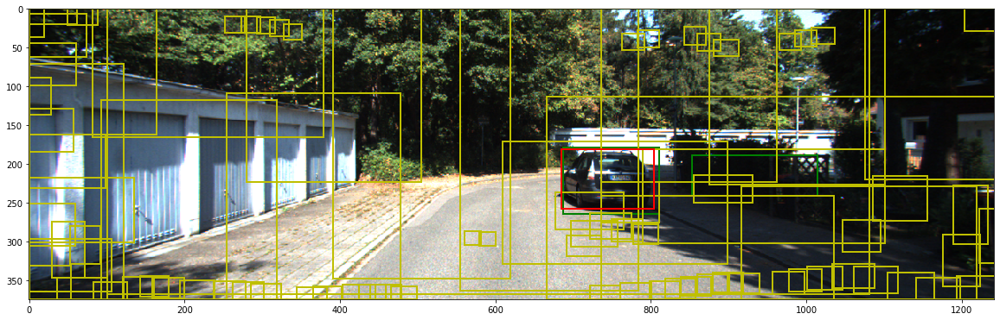

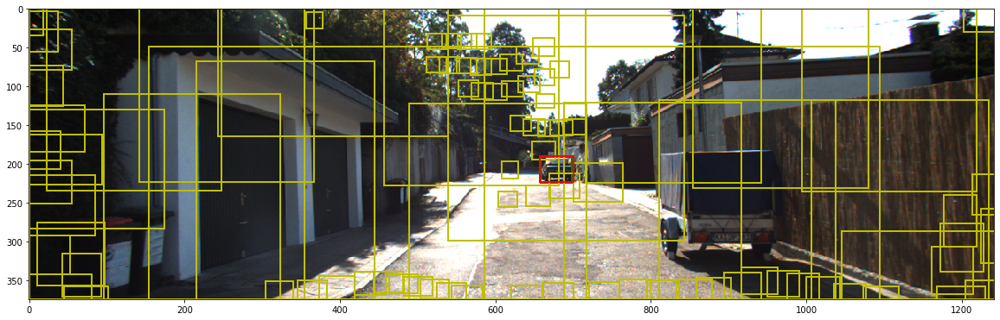

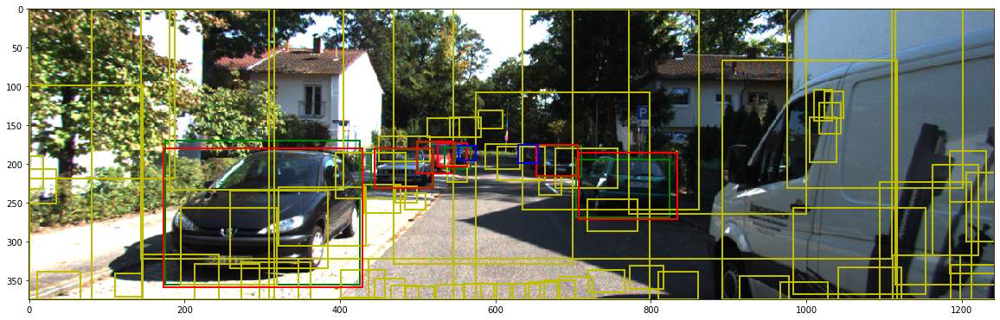

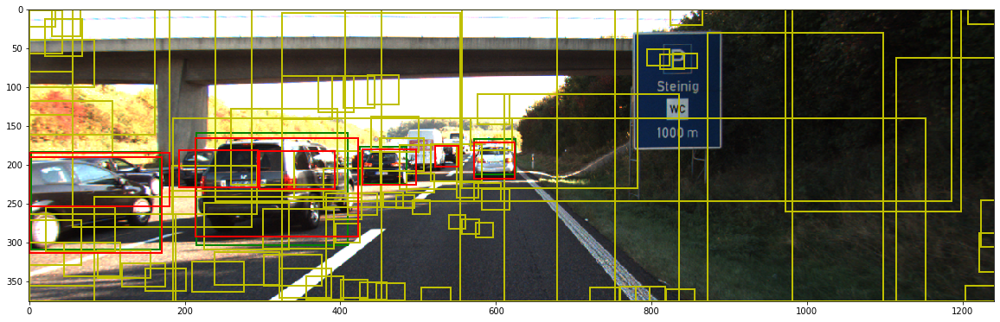

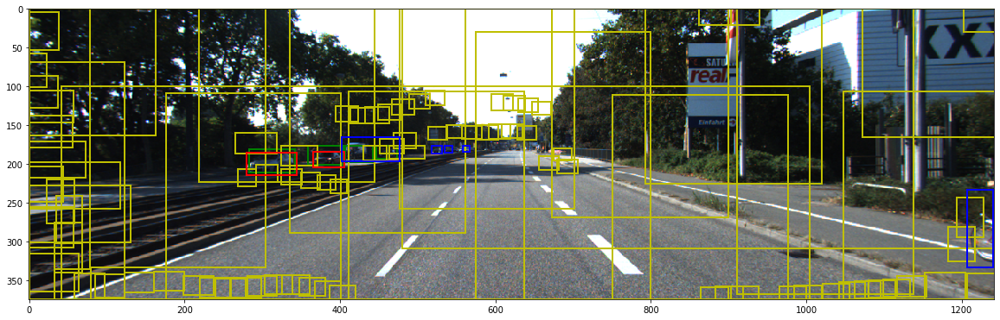

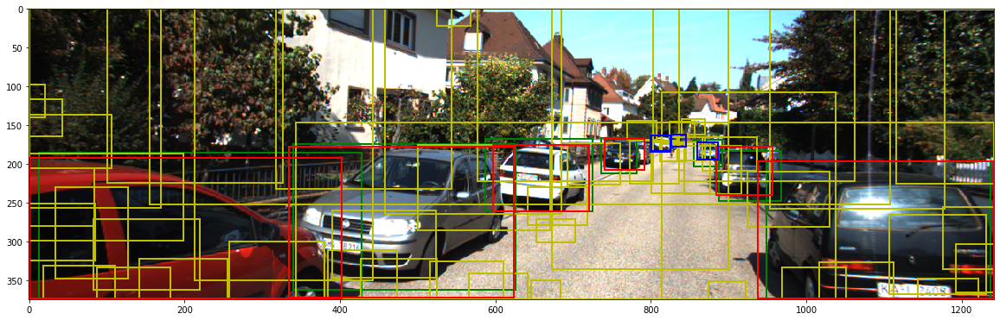

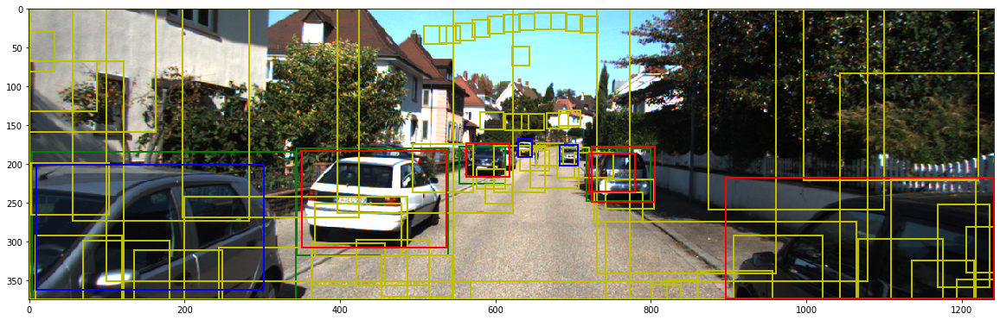

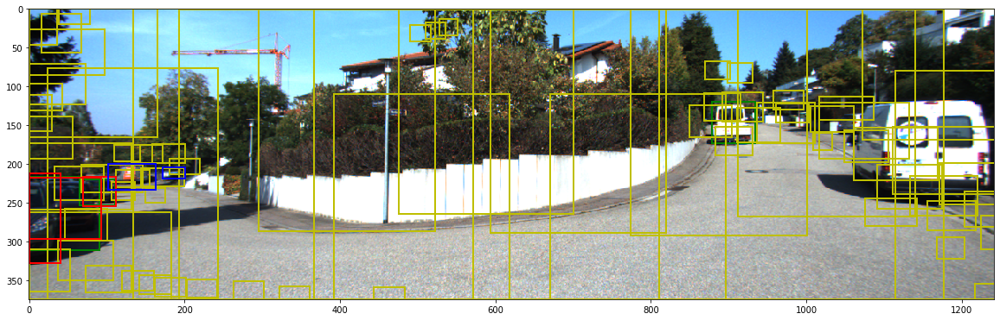

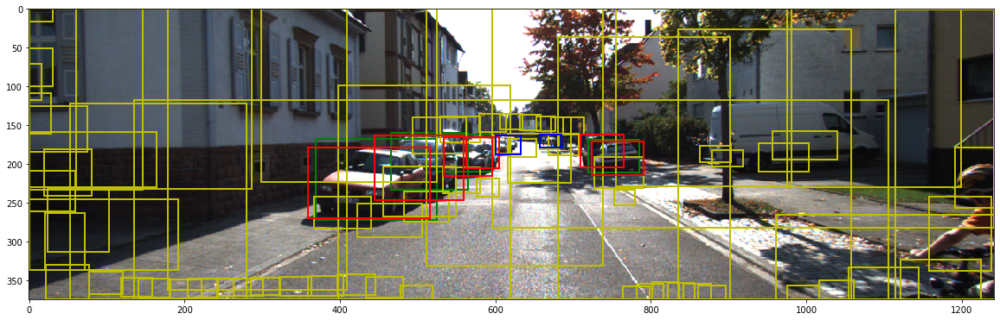

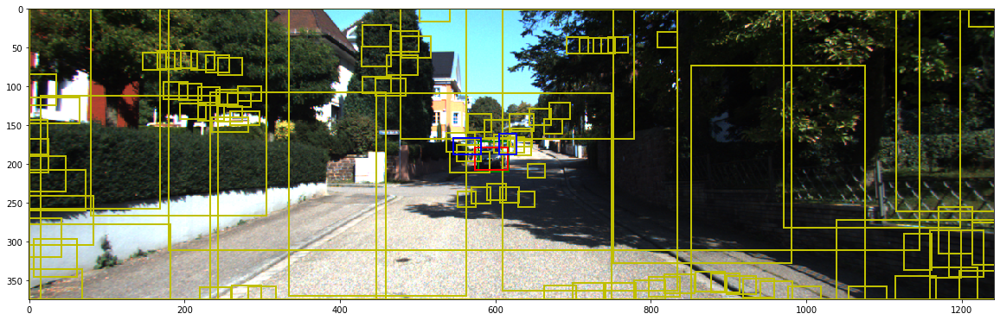

In [22]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_kitti_cars_detections_val.hdf5")

for idx, miou in worst_pred_idx[:10]:    
    display_img("kitti", idx, kitti_val_dataset, save_path)

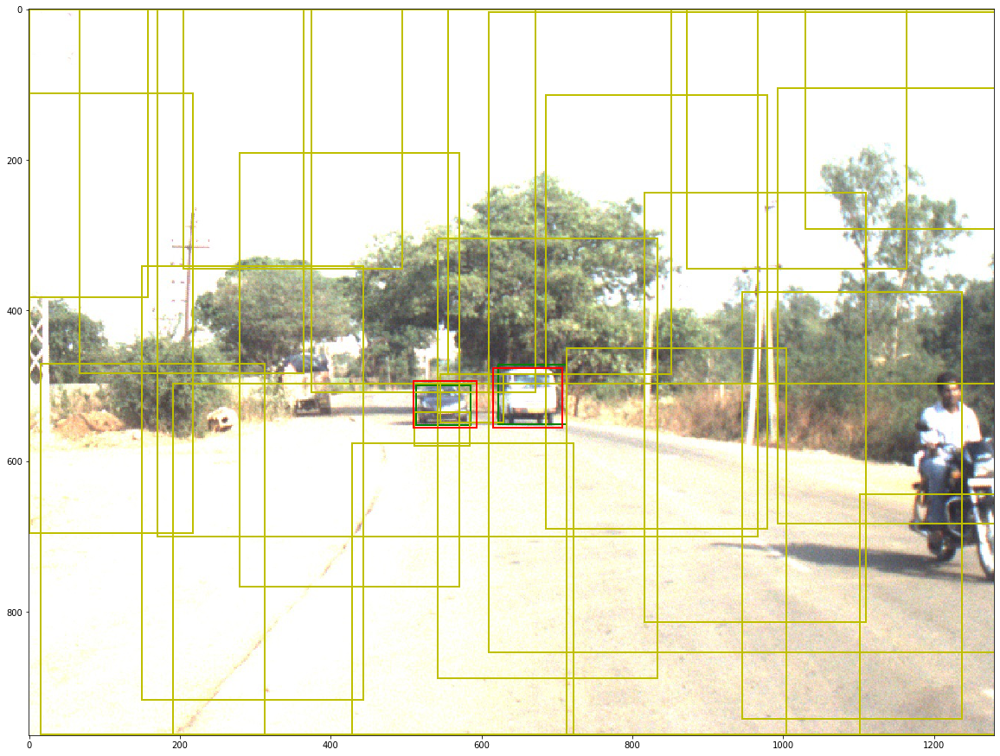

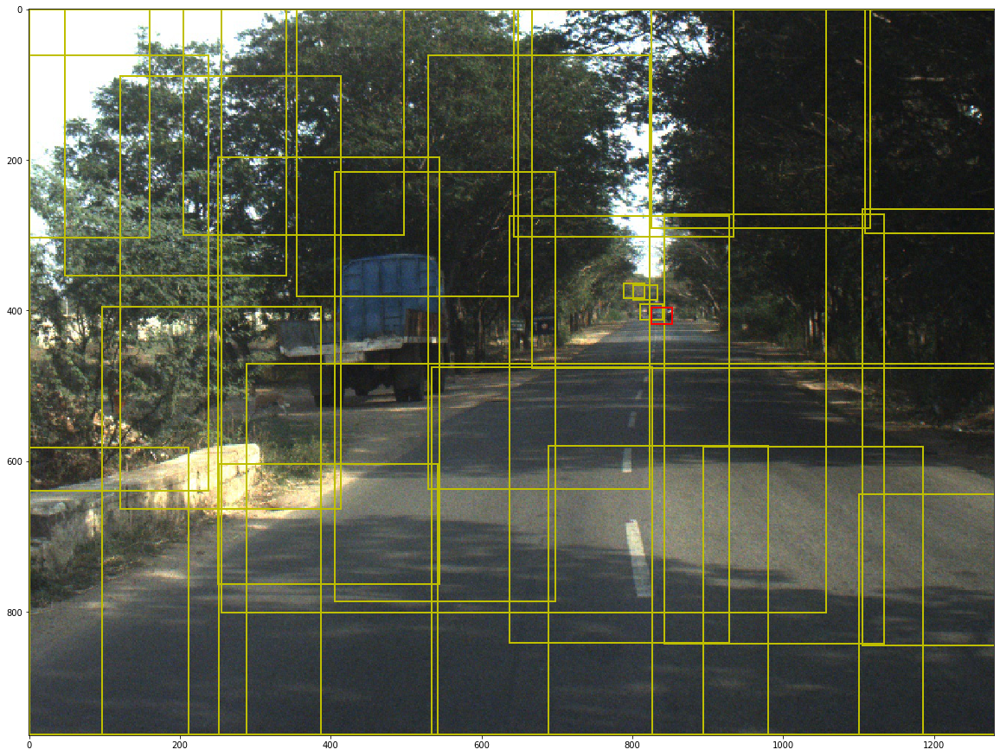

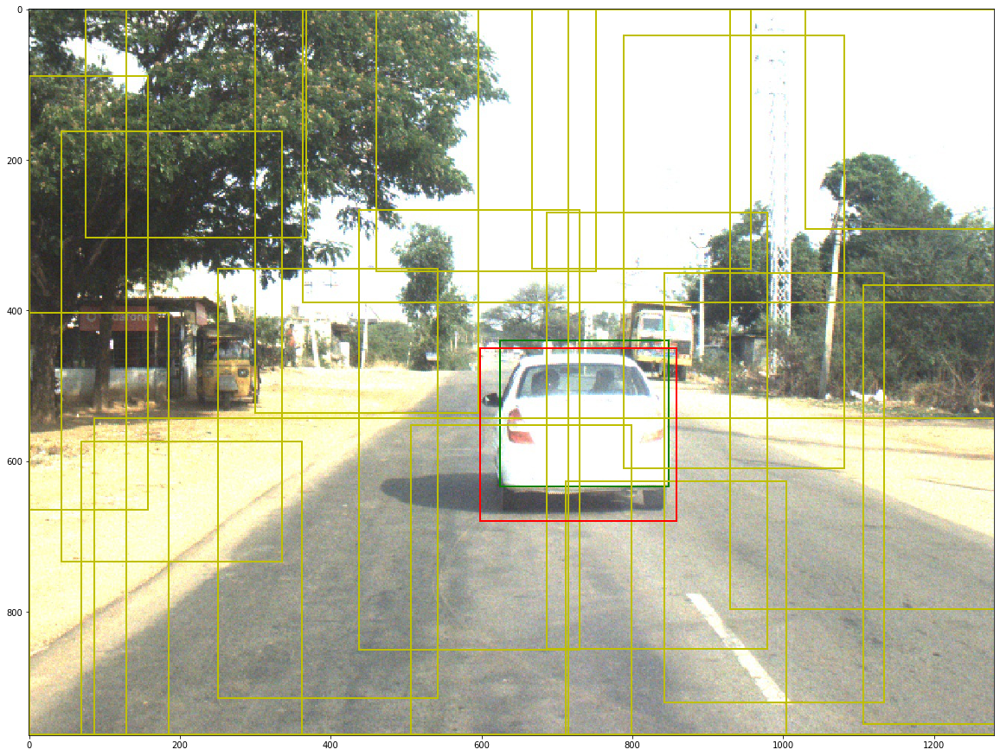

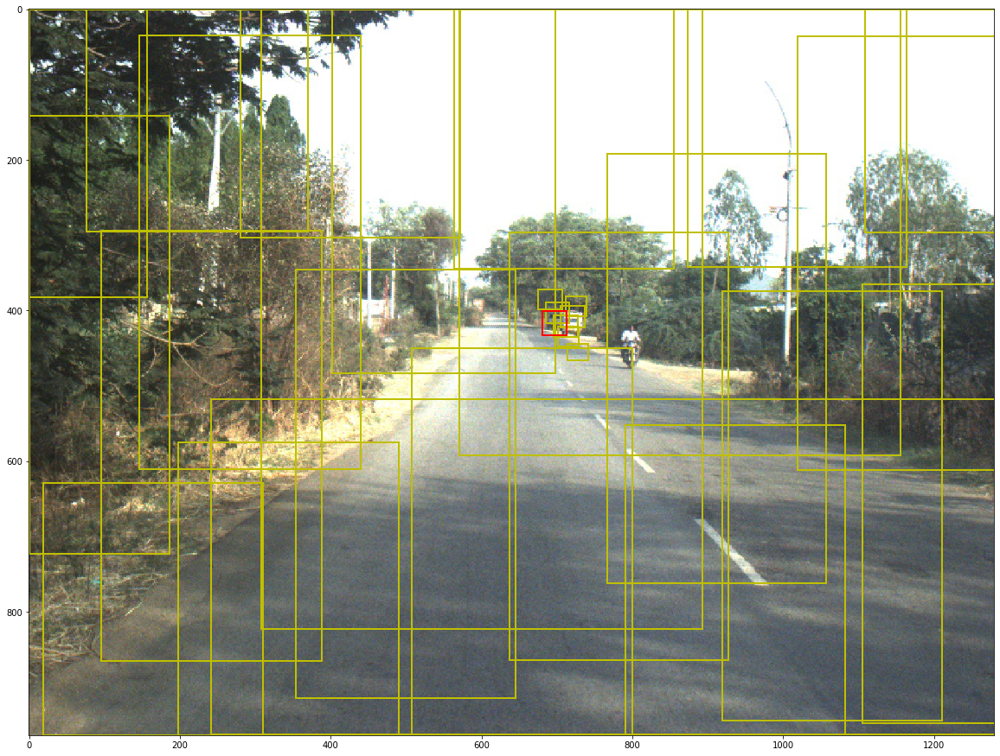

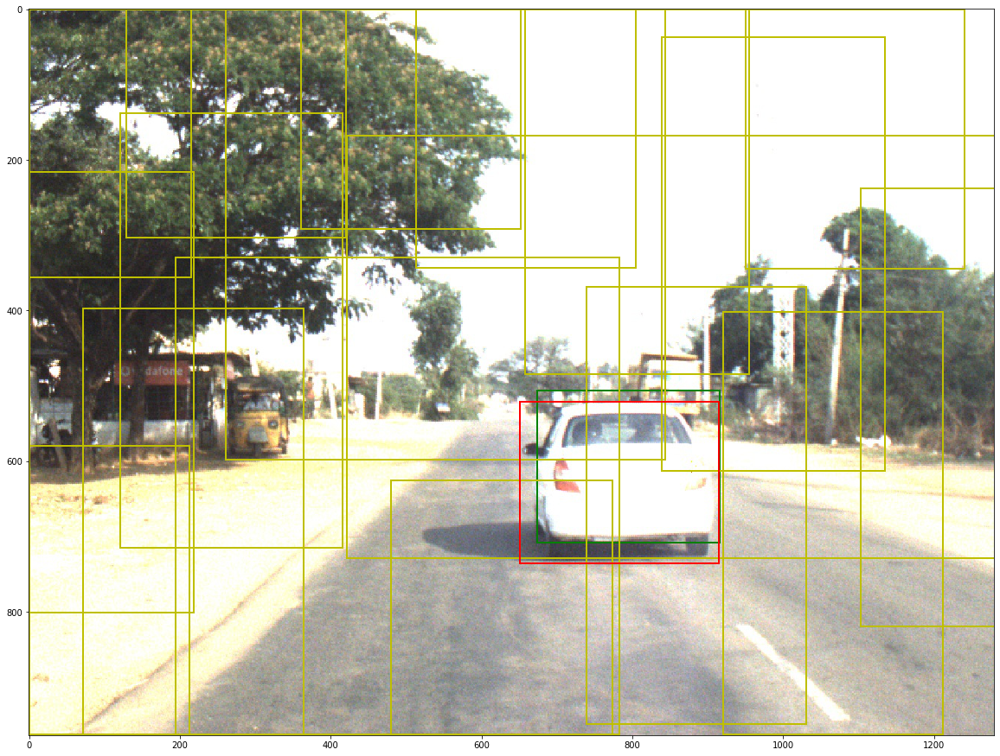

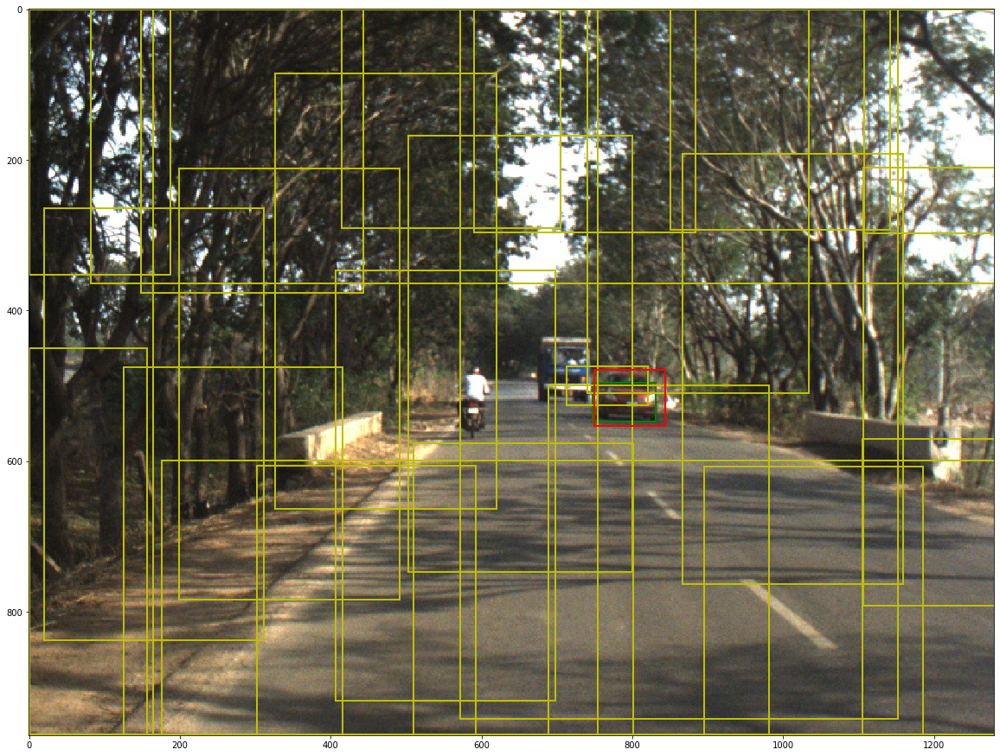

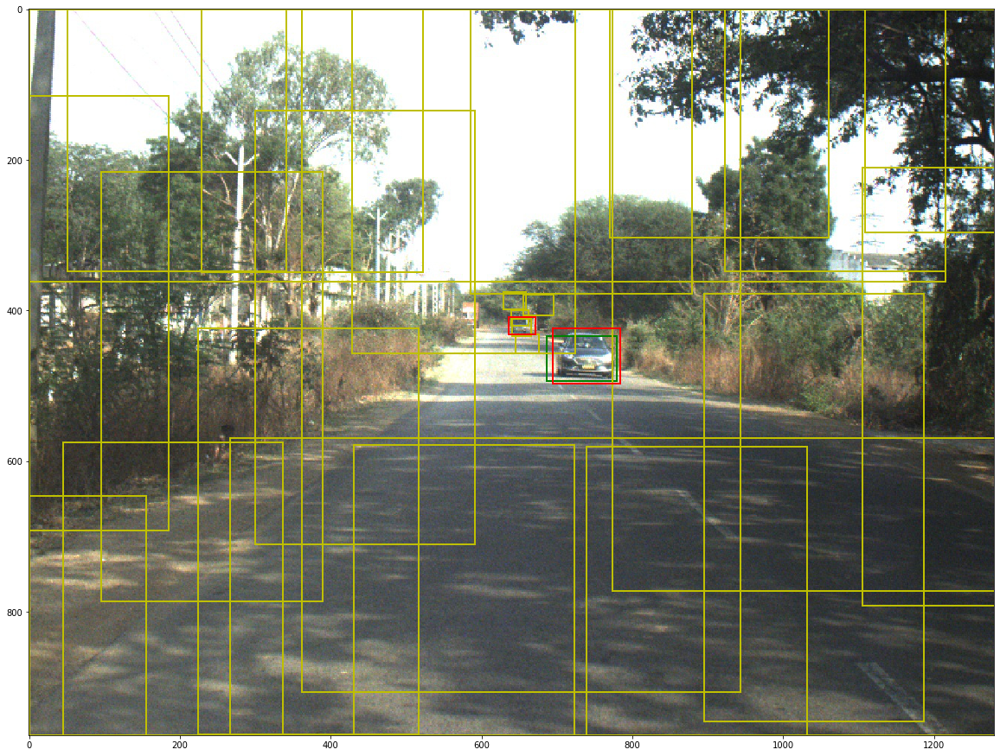

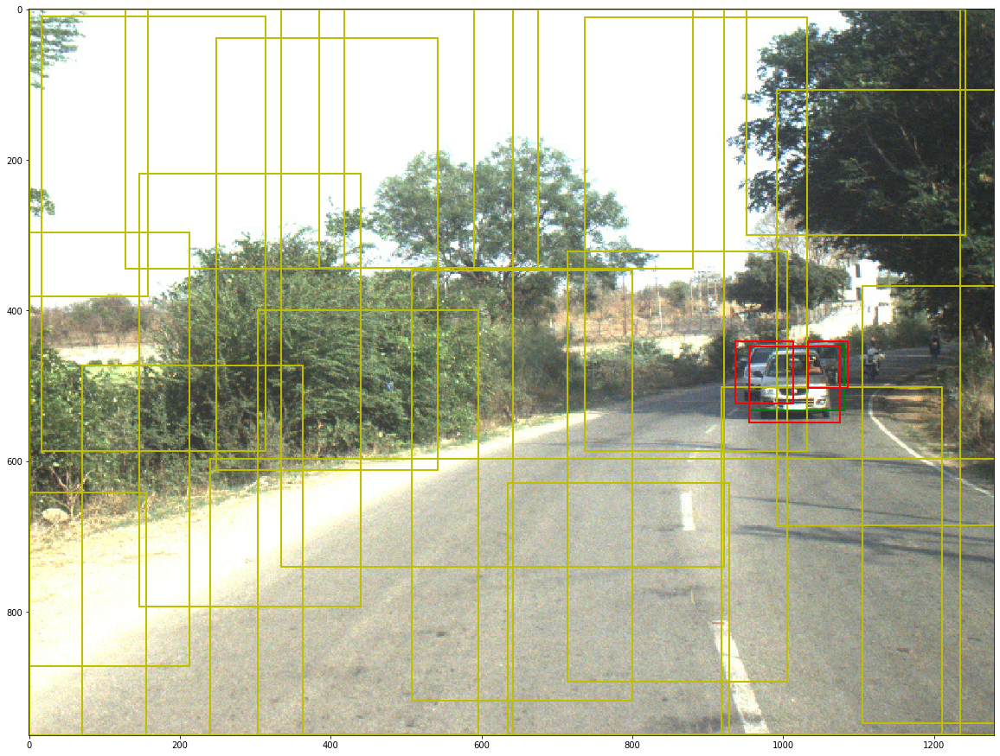

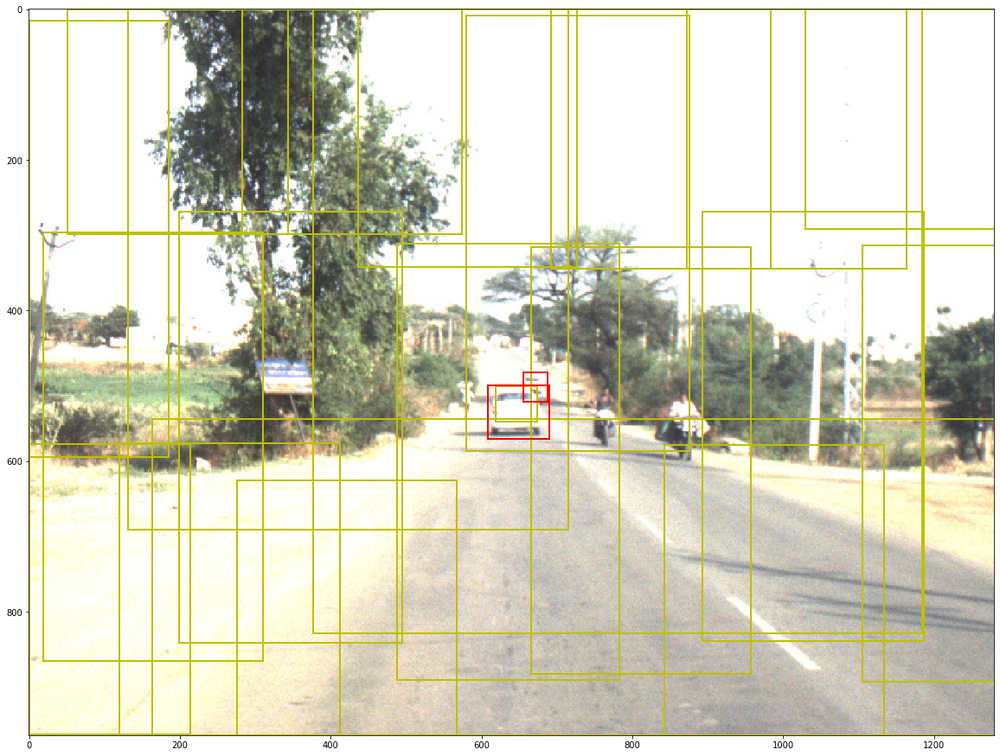

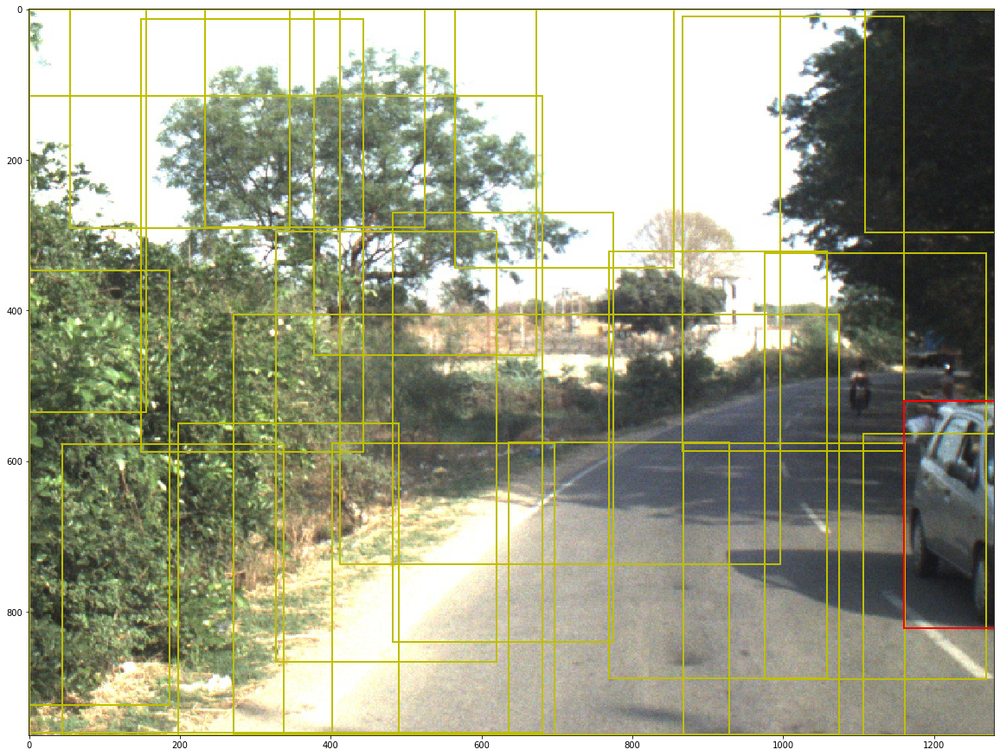

In [23]:
save_path = os.path.join(CHECKPOINT_DIR, "subset_idd_cars_detections_val.hdf5")

for idx, miou in worst_pred_idx[:10]:    
    display_img("idd", idx, idd_val_dataset, save_path)